In [19]:
import pandas as pd

file_path = ('Review.csv')
df = pd.read_csv(file_path)
df.head()

,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text
0,1,B001E4KFG0,A3SGXH7AUHU8GW,delmartian,1,1,5,1303862400,Good Quality Dog Food,I have bought several of the Vitality canned d...
1,2,B00813GRG4,A1D87F6ZCVE5NK,dll pa,0,0,1,1346976000,Not as Advertised,Product arrived labeled as Jumbo Salted Peanut...
2,3,B000LQOCH0,ABXLMWJIXXAIN,"Natalia Corres ""Natalia Corres""",1,1,4,1219017600,"""Delight"" says it all",This is a confection that has been around a fe...
3,4,B000UA0QIQ,A395BORC6FGVXV,Karl,3,3,2,1307923200,Cough Medicine,If you are looking for the secret ingredient i...
4,5,B006K2ZZ7K,A1UQRSCLF8GW1T,"Michael D. Bigham ""M. Wassir""",0,0,5,1350777600,Great taffy,Great taffy at a great price. There was a wid...


In [20]:
import re
import nltk
from nltk.corpus import stopwords
from nltk.stem import WordNetLemmatizer
nltk.download('stopwords')
nltk.download('wordnet')

# Initialize lemmatizer and stop words
lemmatizer = WordNetLemmatizer()
stop_words = set(stopwords.words('english'))

def preprocess_text(text):
    # Convert text to lowercase
    text = text.lower()
    # Remove HTML tags
    text = re.sub(r'<.*?>', '', text)
    # Remove punctuation and numbers
    text = re.sub(r'[^a-z\s]', '', text)
    # Tokenization
    tokens = text.split()
    # Remove stop words and lemmatize
    tokens = [lemmatizer.lemmatize(word) for word in tokens if word not in stop_words]
    return ' '.join(tokens)

# Apply the preprocessing function to the review text
df['Cleaned_Text'] = df['Text'].apply(preprocess_text)

# Display the first few rows of the dfset after preprocessing
df[['Text', 'Cleaned_Text']].head()


[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\vedan\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\vedan\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


,Text,Cleaned_Text
0,I have bought several of the Vitality canned d...,bought several vitality canned dog food produc...
1,Product arrived labeled as Jumbo Salted Peanut...,product arrived labeled jumbo salted peanutsth...
2,This is a confection that has been around a fe...,confection around century light pillowy citrus...
3,If you are looking for the secret ingredient i...,looking secret ingredient robitussin believe f...
4,Great taffy at a great price. There was a wid...,great taffy great price wide assortment yummy ...


In [21]:
df.head()

,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text,Cleaned_Text
0,1,B001E4KFG0,A3SGXH7AUHU8GW,delmartian,1,1,5,1303862400,Good Quality Dog Food,I have bought several of the Vitality canned d...,bought several vitality canned dog food produc...
1,2,B00813GRG4,A1D87F6ZCVE5NK,dll pa,0,0,1,1346976000,Not as Advertised,Product arrived labeled as Jumbo Salted Peanut...,product arrived labeled jumbo salted peanutsth...
2,3,B000LQOCH0,ABXLMWJIXXAIN,"Natalia Corres ""Natalia Corres""",1,1,4,1219017600,"""Delight"" says it all",This is a confection that has been around a fe...,confection around century light pillowy citrus...
3,4,B000UA0QIQ,A395BORC6FGVXV,Karl,3,3,2,1307923200,Cough Medicine,If you are looking for the secret ingredient i...,looking secret ingredient robitussin believe f...
4,5,B006K2ZZ7K,A1UQRSCLF8GW1T,"Michael D. Bigham ""M. Wassir""",0,0,5,1350777600,Great taffy,Great taffy at a great price. There was a wid...,great taffy great price wide assortment yummy ...


In [22]:
# Categorizing sentiment based on the Score
def categorize_sentiment(score):
    if score >= 4:
        return 'Positive'
    elif score == 3:
        return 'Neutral'
    else:
        return 'Negative'

# Applying the function to create a new 'Sentiment' column
df['Sentiment'] = df['Score'].apply(categorize_sentiment)

# Checking the distribution of sentiments
sentiment_distribution = df['Sentiment'].value_counts(normalize=True) * 100
sentiment_distribution


Sentiment
Positive    77.9688
Negative    14.5094
Neutral      7.5218
Name: proportion, dtype: float64

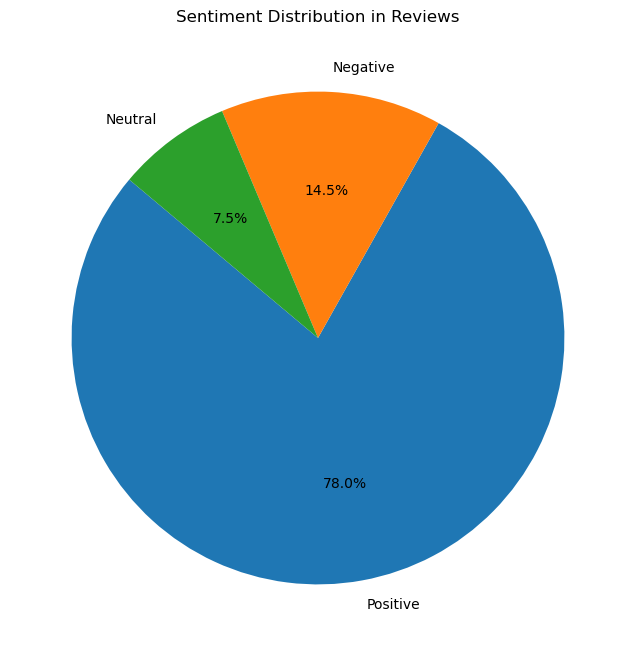

In [23]:
import matplotlib.pyplot as plt

# Pie chart for sentiment distribution
plt.figure(figsize=(8, 8))
plt.pie(sentiment_distribution, labels=sentiment_distribution.index, autopct='%1.1f%%', startangle=140)
plt.title('Sentiment Distribution in Reviews')
plt.show()


In [26]:
# Categorizing sentiment based on the Score
def categorize_sentiment(score):
    if score >= 4:
        return 'Positive'
    elif score == 3:
        return 'Neutral'
    else:
        return 'Negative'

# Applying the function to create a new 'Sentiment' column
df['Sentiment'] = df['Score'].apply(categorize_sentiment)

# Calculating average helpfulness numerator and denominator for each sentiment
avg_helpfulness = df.groupby('Sentiment').agg({
    'HelpfulnessNumerator': 'mean',
    'HelpfulnessDenominator': 'mean'
})

# Adding a column for the ratio of helpfulness
avg_helpfulness['HelpfulnessRatio'] = avg_helpfulness['HelpfulnessNumerator'] / avg_helpfulness['HelpfulnessDenominator']

# Handling any potential division by zero
avg_helpfulness['HelpfulnessRatio'] = avg_helpfulness['HelpfulnessRatio'].fillna(0)

# Display the results
print(avg_helpfulness)

           HelpfulnessNumerator  HelpfulnessDenominator  HelpfulnessRatio
Sentiment                                                                
Negative               2.434739                4.244131          0.573672
Neutral                1.711877                2.481800          0.689773
Positive               1.633135                1.847016          0.884202


The computed values provide interesting insights into how users perceive the helpfulness of reviews with different sentiments (Negative, Neutral, Positive) in your dataset. Let's analyze each aspect:

1. **HelpfulnessNumerator (Average Number of Helpful Votes)**:
   - **Negative Reviews**: On average, receive about 2.43 helpful votes.
   - **Neutral Reviews**: On average, receive about 1.71 helpful votes.
   - **Positive Reviews**: On average, receive about 1.63 helpful votes.
   
   Interestingly, negative reviews have a higher number of helpful votes on average compared to neutral and positive reviews. This might suggest that users find negative reviews more informative or valuable when making decisions or understanding the product.

2. **HelpfulnessDenominator (Average Number of Total Votes)**:
   - **Negative Reviews**: On average, receive about 4.24 total votes.
   - **Neutral Reviews**: On average, receive about 2.48 total votes.
   - **Positive Reviews**: On average, receive about 1.85 total votes.
   
   Negative reviews not only have more helpful votes but also more total votes, indicating higher user engagement. This could imply that users are more inclined to evaluate and vote on negative reviews, possibly because they weigh bad experiences more heavily.

3. **HelpfulnessRatio (Ratio of Helpful Votes to Total Votes)**:
   - **Negative Reviews**: About 57.37% of the votes are helpful.
   - **Neutral Reviews**: About 68.98% of the votes are helpful.
   - **Positive Reviews**: About 88.42% of the votes are helpful.
   
   While negative reviews get more attention and helpful votes in absolute terms, it's the positive reviews that have a higher ratio of being found helpful. This means that when users vote on positive reviews, they are more likely to consider them helpful. Neutral reviews, while fewer in total votes, also have a relatively high helpfulness ratio.

### Interpretation:
- **Negative Reviews**: They garner more attention and are often deemed useful, likely because they provide cautionary information that could influence purchasing decisions. However, the helpfulness ratio is lower than for positive reviews, indicating a mixed response from the readers.
- **Neutral Reviews**: They have a decent helpfulness ratio but lower overall engagement, suggesting that they might be providing balanced information that some users find valuable.
- **Positive Reviews**: They are generally found to be helpful by a higher proportion of readers who vote on them, which could indicate a trust in positive feedback or a preference for affirmative experiences shared by others.

### Conclusion:
- These patterns could be reflective of a phenomenon where negative experiences or critiques are more heavily scrutinized and discussed, but once users engage with positive reviews, they tend to agree with them or find them useful.
- This insight can be valuable for businesses and platforms in understanding consumer behavior and the impact of different types of reviews on user perception and decision-making.

In [27]:
!pip install textblob


In [28]:
from textblob import TextBlob

# Define a function to get polarity and subjectivity
def analyze_sentiment(Cleaned_Text):
    analysis = TextBlob(Cleaned_Text)
    return analysis.sentiment.polarity, analysis.sentiment.subjectivity

# Apply the function to each review
df['Polarity'], df['Subjectivity'] = zip(*df['Cleaned_Text'].apply(analyze_sentiment))

# Example: Display the first few rows with the new columns
print(df[['Text', 'Polarity', 'Subjectivity']].head())

                                                Text  Polarity  Subjectivity
0  I have bought several of the Vitality canned d...  0.425000      0.400000
1  Product arrived labeled as Jumbo Salted Peanut...  0.216667      0.762963
2  This is a confection that has been around a fe...  0.187000      0.548000
3  If you are looking for the secret ingredient i...  0.150000      0.650000
4  Great taffy at a great price.  There was a wid...  0.458333      0.600000


The output from the sentiment analysis using TextBlob gives us two key metrics for each review: Polarity and Subjectivity. Let's explore how these can provide insights for customer segmentation and marketing strategies:

1. **Polarity**:
   - **High Positive Polarity**: Reviews with high positive polarity (close to 1) are extremely positive. Customers who leave such reviews are likely very satisfied and could be targeted as brand advocates. Marketing strategies could involve engaging these customers through loyalty programs or using their reviews in promotional materials.
   - **High Negative Polarity**: Reviews with high negative polarity (close to -1) indicate strong dissatisfaction. This segment of customers may require follow-up to address their concerns, and their feedback can be crucial for product improvement.
   - **Neutral Polarity**: Reviews with neutral polarity (close to 0) might come from customers who are indifferent or have mixed feelings. Understanding the reasons behind their neutrality can help in refining products or services to better meet their expectations.

2. **Subjectivity**:
   - **High Subjectivity**: Reviews with high subjectivity contain personal opinions, emotions, or assumptions. These reviews can be a rich source of qualitative data, revealing how customers feel about your product or service.
   - **Low Subjectivity**: Reviews with low subjectivity are more factual and objective. They can be used to understand the specific, concrete issues or features that customers care about.

### Applying Insights for Customer Segmentation and Marketing:  (Future Scope)

- **Segmentation by Satisfaction Level**: Group customers based on their polarity scores. Highly positive reviewers can be targeted for loyalty programs, while negative reviewers might be segmented for outreach and support.

- **Content Analysis for Marketing**: Analyze highly subjective, positive reviews to extract emotive language that resonates with satisfied customers. This language can be used in marketing campaigns to appeal to similar customer segments.

- **Product Development and Improvement**: Use objective, negative reviews to identify specific issues or features that need improvement. This can guide product development efforts.

- **Targeted Communication**: Tailor communication strategies based on the sentiment and subjectivity of past reviews. For instance, engage with highly subjective reviewers with more personalized communication, as they may respond better to an emotional appeal.

- **Trend Analysis**: Look for patterns over time in polarity and subjectivity to understand changing customer attitudes. This can inform both long-term strategy and immediate tactical decisions.

By leveraging these insights, you can not only improve your understanding of different customer segments but also tailor your marketing and product development strategies to better meet the needs and preferences of your customers.

In [29]:
import pandas as pd
from collections import Counter
import re

# Filter for objective (subjectivity < 0.5) and negative (polarity < 0)

negative_objective_reviews = df[(df['Polarity'] < 0) & (df['Subjectivity'] < 0.5)]

# Function to clean and tokenize Cleaned_text
def clean_and_tokenize(Cleaned_Text):
    # Remove punctuation and numbers
    Cleaned_Text = re.sub(r'[^a-zA-Z\s]', '', Cleaned_Text, re.I|re.A)
    # Tokenize
    tokens = Cleaned_Text.lower().split()
    return tokens

# Apply the function and get a list of all words in these reviews
words = negative_objective_reviews['Cleaned_Text'].apply(clean_and_tokenize).sum()

# Count the frequency of each word
word_counts = Counter(words)

# Display most common words
common_words = word_counts.most_common(20)
print(common_words)


[('like', 9384), ('product', 7084), ('one', 6857), ('food', 5975), ('taste', 5922), ('tea', 5125), ('would', 4863), ('dog', 4676), ('flavor', 4468), ('get', 4235), ('time', 4188), ('bag', 3880), ('coffee', 3709), ('dont', 3566), ('box', 3494), ('little', 3379), ('cat', 3225), ('buy', 2999), ('even', 2959), ('really', 2894)]


In [30]:
pip install wordcloud


Note: you may need to restart the kernel to use updated packages.


In [31]:
pip install Pillow --upgrade


Note: you may need to restart the kernel to use updated packages.


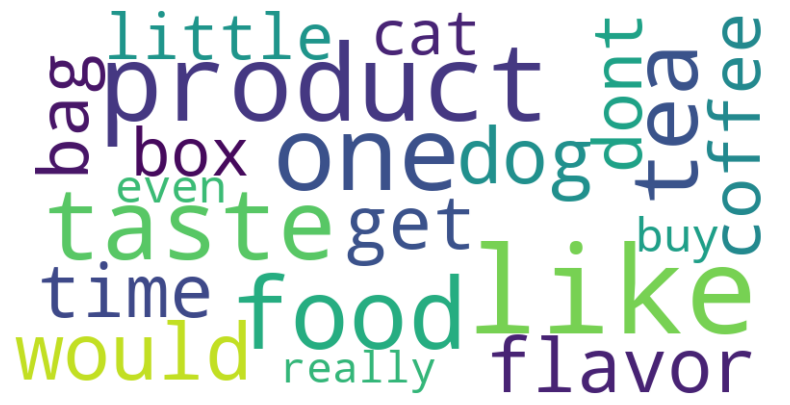

In [32]:
from wordcloud import WordCloud
import matplotlib.pyplot as plt


# Assuming 'common_words' is your list of common words and their counts
# Convert the list of tuples into a dictionary
word_freq = dict(common_words)

# Create a WordCloud object
wordcloud = WordCloud(width=800, height=400, background_color='white').generate_from_frequencies(word_freq)

# Plotting the WordCloud
plt.figure(figsize=(10, 5))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.show()


In [33]:
# Import necessary libraries
import pandas as pd
import matplotlib.pyplot as plt

# Ensure plots are displayed inline in the Jupyter Notebook
%matplotlib inline


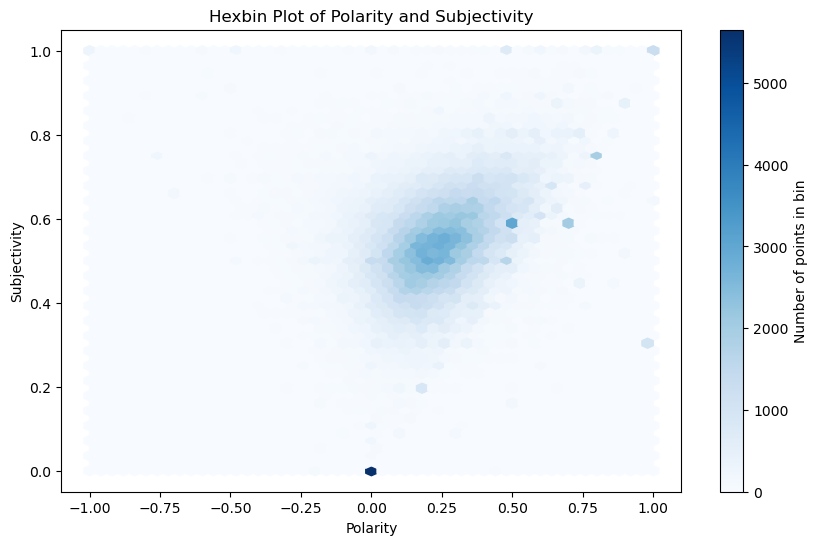

In [34]:
# Set the size of the plot
plt.figure(figsize=(10, 6))

# Create a Hexbin Plot
plt.hexbin(df['Polarity'], df['Subjectivity'], gridsize=50, cmap='Blues')

# Adding a color bar
plt.colorbar(label='Number of points in bin')

# Set titles and labels
plt.title('Hexbin Plot of Polarity and Subjectivity')
plt.xlabel('Polarity')
plt.ylabel('Subjectivity')

# Show the plot
plt.show()


Based on the provided Hexbin Plot, here are some insights that can be gleaned:

#Polarity Distribution:
The data points are more densely packed towards the center of the polarity axis. This suggests that the majority of the text data is neutral, with fewer very positive or very negative sentiment scores.

###Subjectivity Distribution: Similarly, the subjectivity scores are also centered around a mid-range value. This indicates that most text data is moderately subjective, neither being too objective (fact-based) nor too subjective (opinion-based).

###Correlation: There is no clear pattern indicating a strong correlation between polarity and subjectivity. However, there might be a slight trend where texts with neutral sentiment (polarity close to zero) tend to have a wider range of subjectivity scores.

###Outliers: There seem to be few data points with extreme polarity or subjectivity scores, as indicated by isolated hexagons on the plot's periphery.

###Neutral Texts: The highest density area is slightly above zero on the polarity scale, suggesting a tendency for the text to be slightly positive overall.

This plot is useful for understanding the overall sentiment trends within your dataset and can help in making decisions regarding sentiment analysis, customer feedback, and other text-based evaluations.

In [35]:
# Filter out the negative feedback that is also subjective
negative_subjective_feedback = df[(df['Polarity'] < 0) & (df['Subjectivity'] > 0.5)]

# Review the negative, subjective feedback
for index, row in negative_subjective_feedback.iterrows():
    print(f"Review {index}: {row['Cleaned_Text']}")
    print(f"Polarity: {row['Polarity']}, Subjectivity: {row['Subjectivity']}\n")

# At this point, you would perform a qualitative analysis of the text in the `negative_subjective_feedback` DataFrame

Review 14: strawberry twizzlers guilty pleasure yummy six pound around son
Polarity: -0.5, Subjectivity: 1.0

Review 52: wasnt stock last time looked go vermont country store weston find along jaw harp cranberry horseradish sauce fartless black bean salsa apple cider jelly newton cradle art motion staple vermont maple syrupback as kickin peanut hot activate perspiration gland behind ear arm requires beverage advertised glass cold milk box kleenex since make nose run look like ordinary peanut already giving idea work suspect people hitting goody absence especially colleague greg im going take work earliest opportunity empty content ordinary planter peanut see whose cry whose nose running returnthe shaken ensure spice evenly distributed important wash hand consumption touch eyesyoull go nut asskickin peanutsps im sharing peanut deliberately ill probably give greg jaw harp christmas hell insulted
Polarity: -0.13576388888888888, Subjectivity: 0.6291666666666667

Review 67: purchased mango 

Review 31345: wanted badly like meal since rarely go lunch awful look taste like gravy noodle potted meat mixed bowl ordered three different variety worst
Polarity: -0.39999999999999997, Subjectivity: 0.736111111111111

Review 31380: bulldog love dose smell bad flavor
Polarity: -0.09999999999999992, Subjectivity: 0.6333333333333333

Review 31411: wantd make barefoot contessas recipe strawberry scone call dried strawberry expecting get something akin dried cranberry raisin disappointed called candied strawberry since hardly resembled fruit coated sugar ok recipe cant feel good feeding family save money priceyand use craisins instead go chocolate
Polarity: -0.04027777777777778, Subjectivity: 0.5986111111111111

Review 31441: consider purchasing different product juice contained plastic one known bpa widely told avoid especially baby
Polarity: -0.03333333333333333, Subjectivity: 0.6666666666666666

Review 31483: dont know didnt read description closelythis sugar drinkargh people rating hi

Review 58680: skeptical ordering yet another sugar subsitute taste like sugar isnt pleasantly surprised used xylitol first time morning taste like regular sugar fake sugar substitute taste like splenda even stevia amazing enjoy coffee without taste sugar substitute leavei highly recommend product anyone cannot use regulard sugar hate sugar substitute taste
Polarity: -0.032222222222222215, Subjectivity: 0.6278062678062678

Review 58689: xylitol packet chalky taste hate far bought epic natrazyle xylitol one worth buying againdo favor buy something else
Polarity: -0.07500000000000002, Subjectivity: 0.6

Review 58730: combination skin green tea aloe moisturizer leaf skin supple hydrated oily subtle clean scent refreshingi also tried jasmine vitamin e moisturizer much richer bit rich skin fragrance also stronger ill stick green tea aloe
Polarity: -0.041666666666666664, Subjectivity: 0.5357142857142857

Review 58740: hard time finding moisterizer oily tzone rest face dry point flakey word ca

Review 92850: store dont carry gfi chai tea latte anymore find price excessive buying way saved ton moneyand actually prefer flavor starbucks version
Polarity: -0.125, Subjectivity: 0.55

Review 92856: happy lamb ear recieved oily nasty residue
Polarity: -0.09999999999999998, Subjectivity: 1.0

Review 92867: dont think quick meal unless use leftover chicken chicken cooked ahead timeto make dinner need purchase lb chicken breaststo add flavor seasoned chicken garlic powder mr dash chicken seasoning poultry seasoning cooking followed instruction box youre familiar orzo pasta pasta used meal look similar white rice broccoli used dried floret piece tiny dried color dried parsley isnt much broccoli included added moremy family thought meal okay thought didnt enough flavor thought pasta soft maybe overcooked thought salty typical box meal kit meal okaynutrition fact prepared dinnercalories total fat g saturated g trans fat cholesterol mgsodium mg carbohydrate gdietary fibergsugars gprotein g

Review 121700: evetually give eat food doesnt dive right hoped would granted picky eater elderly cat hoped would really enjoy brand organic food better cook grind food heck made baby food daughter baby whats difference old sickly kitty cat expensive brand cat food probably save money making disappointed poor old lady fixed income eat cat food buy med obamacare brand want eat
Polarity: -0.08785714285714286, Subjectivity: 0.5042857142857142

Review 121713: selected plato treat due natural ingredient wow pug ponch love currently bag duck salmon chicken get home walk run straight kitchen run circle waiting fridge treat treat ill buy
Polarity: -0.040625, Subjectivity: 0.640625

Review 121718: even though thing smell terrible dog love probably order run
Polarity: -0.25, Subjectivity: 0.8

Review 121760: followed direction falafel mix cupadd cup water falafel box oz add cup water would think total mix box cup correct found little leftit wonderful surprisei like flaver texture little rough mad

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Review 470643: use food aging cat get quarter teaspoon miralax twice day mix dose half food lap gravy rarely eats meat food shell take miralax get cheaper local grocery theyre often sometimes shell eat prime filet turkey chicken tuna chicken favorite
Polarity: -0.09444444444444444, Subjectivity: 0.6611111111111111

Review 470662: soon opened bottle cat went crazy love stuff funny watch much weird get already pretty weird itthanks
Polarity: -0.09999999999999999, Subjectivity: 0.9166666666666666

Review 470664: ive buying cosmic catnip year occasionally ive given brand cat know difference go crazy cosmic toy
Polarity: -0.3, Subjectivity: 0.5125

Review 470668: even though dont cat ill buy one repel annoying roach hope workbecoz intoxicate better boric acid
Polarity: -0.26666666666666666, Subjectivity: 0.7999999999999999

Review 470678: really like set meat cheesesunfortunately one way overpriced size contentsthe photograph really make look like getting deal cant read weight product reaso


Review 494712: received product unit already leaking heavily figured burst transit big deal right however cleaning rest unit noticed gentle pressure seam leaking easily one didnt leak took runthat burst pocketno pressure applied far could tell contacted seller told happens wrote powerbar week ago response buying againthat said able try unit love stuff gel thin enough slide dry throat hot day taste isnt bad citrus help salivate bit help werent poor packaging horrible customer service would go gel
Polarity: -0.033174603174603176, Subjectivity: 0.6707142857142856

Review 494725: completed ironman race base nutrition training racing use throughout year try different flavor favorite chocolate yum
Polarity: -0.10000000000000002, Subjectivity: 0.8666666666666667

Review 494763: necessary item bought price gone trying send receive email transaction inconvenient definitely business
Polarity: -0.19999999999999998, Subjectivity: 0.8333333333333334

Review 494771: like idea behind product opinion

Review 14:

Polarity: -0.5 (Negative)
Subjectivity: 1.0 (Subjective)
Insight: The reviewer has a negative opinion about the strawberry twizzlers. They describe them as a "guilty pleasure" and mention that their son likes them, but they also note that they are not very healthy.

Review 52:

Polarity: -0.13576388888888888 (Negative)
Subjectivity: 0.6291666666666667 (Somewhat Subjective)
Insight: The reviewer had a negative experience with a variety of products from a store called "Vermont Country Store." They mention that many of the products were out of stock, and they were not impressed with the quality of the products they did find. They also had a negative experience with a colleague named Greg.

Review 67:

Polarity: -0.2583333333333333 (Negative)
Subjectivity: 0.6370370370370371 (Somewhat Subjective)
Insight: The reviewer did not like the mango-flavored sports nutrition product they tried. They said it had a hint of sweetness, but also an aftertaste that reminded them of licorice. They also mentioned that they have tried many different sports nutrition products over the years, and this was one of the least appealing ones they have tasted.

Review 68:

Polarity: -0.02013888888888889 (Slightly Negative)
Subjectivity: 0.6166666666666667 (Somewhat Subjective)
Insight: The reviewer thought the quality of the baby product they purchased was good, but they felt the price was a little too high, especially when considering the cost of shipping.

Review 69:

Polarity: -0.24999999999999992 (Negative)
Subjectivity: 0.6333333333333333 (Somewhat Subjective)
Insight: The reviewer really liked the taste of the product, but they ate them too quickly and gained weight as a result. They also mentioned that the product is expensive.

Review 99:

Polarity: -0.3533333333333334 (Negative)
Subjectivity: 0.7133333333333333 (Somewhat Subjective)
Insight: The reviewer had a negative experience with a dog food product. They said their golden retriever hated it, wouldn't eat it, and it gave the dog diarrhea. They also mentioned that the product is very expensive.

In [36]:
# Filter out the positive feedback that is not subjective
positive_subjective_feedback = df[ (df['Polarity'] > 0) & (df['Subjectivity'] < 0.5)]

# Review the positive, not subjective feedback
for index, row in positive_subjective_feedback.iterrows():
    print(f"Review {index}: {row['Cleaned_Text']}")
    print(f"Polarity: {row['Polarity']}, Subjectivity: {row['Subjectivity']}\n")

Review 0: bought several vitality canned dog food product found good quality product look like stew processed meat smell better labrador finicky appreciates product better
Polarity: 0.425, Subjectivity: 0.4

Review 11: one boy needed lose weight didnt put food floor chubby guy proteinrich byproduct food higher skinny boy jump higher food sits going stale really go food chubby boy losing ounce week
Polarity: 0.05, Subjectivity: 0.425

Review 15: daughter love twizzlers shipment six pound really hit spot exactly would expectsix package strawberry twizzlers
Polarity: 0.31666666666666665, Subjectivity: 0.35000000000000003

Review 18: twizzlers strawberry childhood favorite candy made lancaster pennsylvania candy inc one oldest confectionery firm united state subsidiary hershey company company established young smylie also make apple licorice twist green color blue raspberry licorice twist like alli keep dry cool place recommended put fridge according guinness book record longest licorice t

Review 6834: anxious try upon first sip apparent drink going go well sharpharsh citrusy metallic flavor combined overwhelming sweetness two seem battle mouth dominance awhile seemed like drink going like syrup carbonated beveragethe small oz regular sized pop oz cost little guy seem little bit astronomicali also bit dubious attempt seem like healthy alternative pop still load sugar claim additional sugar may lead believe sugar low sugar fact gram
Polarity: 0.0425, Subjectivity: 0.49602564102564106

Review 6835: drink taste like soda strong sweetened soda reminds lot fanta back day know say vitamin healthy flavor amount calorie would keep buying drink health drink plenty vitamin flavored water sport drink would serve purpose without calorie want soda certainly wouldnt pay lot money something taste like cost time much guess love taste fanta though
Polarity: 0.3079365079365079, Subjectivity: 0.43412698412698414

Review 6836: second switch im reviewing amazon vine program one perhaps bit b

Review 13531: grateful able obtain organic seed combination grow sprout daily consumption use almost full salad dressing salad lettuce spinach
Polarity: 0.2833333333333333, Subjectivity: 0.39166666666666666

Review 13532: sprout seed mix arrived promptly great condition needed local farmer market ordering soon
Polarity: 0.4, Subjectivity: 0.375

Review 13537: first time sprouting great experience seed starting sprout within hour mostly sprouted second day quite tasty mix enjoy salad sprout lettuce salad
Polarity: 0.325, Subjectivity: 0.36388888888888893

Review 13540: love sprouting seed mixture add tangy interest sproutsgreat salad sandwich live remote area limited access fresh produce sprouting seed add freshness sandwich salad
Polarity: 0.152987012987013, Subjectivity: 0.38857142857142857

Review 13546: gift someone love pop tart thanks much pleased know last
Polarity: 0.3, Subjectivity: 0.4666666666666667

Review 13547: absolutely love poptarts even though arent healthies breakfast

Review 19715: baby love happy baby chick chick meal tried salmon first food month old ever spit back tried feed four different day see would get used change mind luck bad purchase lot lot leftover salmon
Polarity: 0.13571428571428576, Subjectivity: 0.4857142857142857

Review 19717: pediatrician suggested increasing year old protein try upping fish saw online saw ton protien salmonthey arrived mail right away year old big fan love plumb brand fruit veggie pouch like suck straight pouch easy suck straight pouch able cut small spot corner make work putting bowl using spoon made loose much thrillmy month old like im sure ill get older one band wagon
Polarity: 0.15367445054945053, Subjectivity: 0.44909378815628814

Review 19721: pouch next best homemade dont time steam blend baby food always reach happy baby
Polarity: 0.6, Subjectivity: 0.43333333333333335

Review 19747: month old enjoys food much texture fine finished whole packet
Polarity: 0.22916666666666669, Subjectivity: 0.325

Review 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Review 94923: purchased several time always raved everyone best black licorice hard find store amazon make easy
Polarity: 0.195, Subjectivity: 0.4216666666666667

Review 94926: lucky country licorice black cherry oz tub pack candy best ever tasted last order third rd realy good may habit forming tast budsthere several item choose confusing best value oz tub lb total v pound package price found wrong part amazon allow happen send lb bag back wasnt worth time like candyi live gainesville fl zoe ky
Polarity: 0.17878787878787875, Subjectivity: 0.3702380952380952

Review 94931: purchased black licorice thought best id ever love licorice ordered black available found taste like grape fond
Polarity: 0.31333333333333335, Subjectivity: 0.4333333333333334

Review 94933: candy ok different taste one previously bought costco even though supposed flavor one costco said new improved recipe perhaps one old recipe disapointed quality candy fine one already candy eaten nearly fastthis candy brighter re

Review 100902: first syrup local coffee shop drink day pistachio latte never good became usual realized try make drink home save money recently bought bottle glad didfirst amoretti product doorstep faster amazon prime delivered package member secondly syrup delicious ive found pump right amount latte one bottle make well drink also come handy pump ive purchased syrup brand none came thirdly inquiry amoretti order mistake part went beyond rectify situation excellent customer service definitely buying cant wait try flavor
Polarity: 0.23351648351648352, Subjectivity: 0.48992673992673996

Review 100910: best coffee worst get super saver deal appeal overall think best paying
Polarity: 0.26666666666666666, Subjectivity: 0.4533333333333333

Review 100911: price right three bag french vanilla coffee coupon coffee great powering would buy
Polarity: 0.36190476190476195, Subjectivity: 0.42857142857142855

Review 100913: like flavor coffee anything vanilla favorite sometimes take mix another flavo

Review 107449: tried several method recipe nut milk far best nut milk bag ever found use
Polarity: 0.3666666666666667, Subjectivity: 0.43333333333333335

Review 107453: want put bag single layer mouth mason jar use sprouting seed work well mesh fine let water drain jar unless wait half hour soi put mesh mouth jar screwed ring drain
Polarity: 0.05952380952380953, Subjectivity: 0.29365079365079366

Review 107454: overrated candy taste lighter altoilds sugar much money worth cost le dollar
Polarity: 0.25, Subjectivity: 0.15000000000000002

Review 107464: wasabi hot peanut good price also fair delivery promised problem left much residuein mouth im bad teeth problem love wasabi like business amazon make future purchase product amazon j thomas reeve
Polarity: 0.20625, Subjectivity: 0.49270833333333336

Review 107468: review variety rather vendor unless experience oddity vendor seed differ may apply american yard long anything like common cucumber variety market like palebad cantaloupe honeyd

Review 113889: taste yummy year old say recently found daughter gluten intolerant tried dinner one night year old said better tuna helper gotten time past left over family asking
Polarity: 0.075, Subjectivity: 0.2333333333333333

Review 113895: ive made product per package instruction goodive also made first sauteeing celery onion baking casserole topped crushed potato chip wonderfulive also made per instruction added mushroom simmered topped grated cheddar cheese yummy
Polarity: 0.075, Subjectivity: 0.21666666666666667

Review 113907: grew coffee around southeast asian staple pantry yes im talking cafe sua da iced coffee wmilk vietnamese im cambodian drink well ten time better starbucks yum
Polarity: 0.16666666666666666, Subjectivity: 0.16666666666666666

Review 113908: search web lecithin cayenne lecithin natural emulsifier suspends fat bloodstream instead arterial wallscayenne vasodilator lower bloodpressure increase bloodflowthis unique combination lower cholesterol reduces bloodpr

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Review 190284: glove deteriorate month much like dish glove ive tried right pointer finger get pinhole let moisture im left many orphaned left hand glove least made renewable biodegradable materialim going try larger size see recycle left hand glove turning inside wearing right hand
Polarity: 0.10793650793650794, Subjectivity: 0.2968253968253968

Review 190285: really love fact glove packaging environmentally friendly fsc certifiedi love glove chore use glove dish washing due really dry hand problem finding glove last hated using environmentally unfriendly glove lasted maybe couple week typically glove tried developed hole within couple week thrown trash still first pair picked amazon far month going never pair glove last longthese glove good job staying trying slip problem glove also way fit problem water getting unless course accidentally get opening right faucet running submerge glovei wear medium found medium sized glove fit well believe designed fit closely hand slip using medium 

Polarity: 0.25, Subjectivity: 0.4833333333333334

Review 197849: first kcups work discovered although variety choose always went van houtte french vanilla recently ordered ton home still wake morning cup french vanilla love flavor always seem revert back brand flavor trying something new great choice around
Polarity: 0.21079545454545456, Subjectivity: 0.29848484848484846

Review 197857: coffee back order worth wait greatest tasting french vanilla kcup coffee around
Polarity: 0.325, Subjectivity: 0.275

Review 197874: actually thought buying van houtte vanilla coffee kcups usually purchase overlooked description light certainly barely taste vanilla good coffee youre looking real vanilla flavor go van houtte kcups darker yellow package
Polarity: 0.1571428571428571, Subjectivity: 0.2928571428571428

Review 197878: always big fan gloria jean raspberry chocolate bean made wonderful cup coffee house smelled good bean around saw van houtte chocolate raspberry ordered hopping great flavor arom

Review 205016: love several version endangered specie chocolate panther dark terribly sweet prefer order regular basis
Polarity: 0.13999999999999999, Subjectivity: 0.34538461538461535

Review 205019: best chocolate ever bar none fact also healthy mind boggling
Polarity: 0.75, Subjectivity: 0.4

Review 205021: bought chocolate looking way enjoy health benefit chocolate since cant tolerate med cholesterol really wasnt concerned taste ordered find really like taste chocolate chocolate seem sweet ive already gone one box im secondyou get best everything brand fairmarket organic healthy greattasting plus proceeds go help endangered specie really justify taste alone really delicious thing love best last mouth several minute resist biting there much say endangered specie chocolate except writing recommendation making mouth water
Polarity: 0.4269230769230769, Subjectivity: 0.36282051282051275

Review 205031: best super dark chocolate ive ever tastedi snack square two afternoon quality good nee

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Polarity: 0.3444444444444445, Subjectivity: 0.22222222222222224

Review 287731: concluded green tea teabags tasted much like paper bit tea flavor found pg tipsit clean taste better one used including pricey onesi recommend getting one minute hourglass timer use brewing porous teabag get job done fast
Polarity: 0.21333333333333332, Subjectivity: 0.4600000000000001

Review 287732: octavia japanese genmaicha greenhas always favorite mine package much greener dried tea leaf took longer brewand seemed contain le tea transferred tea another container cannot identify tin came next one open keep container
Polarity: 0.08333333333333333, Subjectivity: 0.3833333333333333

Review 287737: two cat almost two year old raised spot stew indoor formula salmon kibble plus canned food weve recently switched kibble due possible grain allergy theyve polished first lb bag seems hit took new flavor right away chow like nothing changed fyi human though variety seems much potent scent salmon flavor cant speak s

Polarity: 0.13636363636363635, Subjectivity: 0.4818181818181818

Review 296064: best ive found marketand picky australian terrier love well australian root come surprise fat level little high due ibd cant total dry matter fat content food minimum level maximum mix fat food carefully pick brand kibble put floor next bowl eats kangaroo ground kibble meal eat unfortunately food novel protein far good combinationwhen month old got bad infection developed ibd lost weight lb lb poop loose water thought going loose diagnosis he steroid getting well managed fooda combination oz kangaroo apple oz lowfat kibble oz canned pumpkin oz addiction venison brushtail canned food together tablespoon metamucil powder increase fiber content total dry matter fat content fat depending batch figure even around got extremely good response addiction requested information max fat level food two serving per day come kcal per daya lot work know worth month later he back lb growing muscle stool fine
Polarity: 0.083

Review 302991: love cake mix cant find local store glad opportunity purchase online think best angel food cake mix market
Polarity: 0.5, Subjectivity: 0.47500000000000003

Review 302993: cake mix sodium lauryl sulphate one main ingredient make soap detergent lather gross
Polarity: 0.08333333333333333, Subjectivity: 0.16666666666666666

Review 302994: love cake another brand also good fave live rural area specialorder sunshine middle summer although three major regional national grocery nearest small town including walmart although carry selection dh cake mix carry brand angel food mix year frustration thought order almost everything else get amazon let see help yeppersthey compared price among several vendor found one price little le used paying large city free shipping happiness last thanks amazon
Polarity: 0.17683209647495365, Subjectivity: 0.34251700680272107

Review 302995: diabetic angle food cake great trying several different brand enjoy duncan hines best bad duncan hines angle 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




Polarity: 0.12142857142857144, Subjectivity: 0.4513668430335096

Review 385736: best coffee ever price realy worth dont forget service five starthey fast delivering coffe thought going go coffee worry herecathy ferrell
Polarity: 0.5, Subjectivity: 0.3333333333333333

Review 385737: cheaper omamhasteaks website usually buy fromgreat deal holiday ship special someone family like steak
Polarity: 0.053571428571428575, Subjectivity: 0.4107142857142857

Review 385747: finally decided order variety package deal knowing could get stuffed sole scallop crabmeat steak well various thing tried steak first disappointed size say way properly portioned usually get quite thin okay best definitely worth money next tried potato au gratin liked different sliced stuff casserole dish remember kid never liked potato ball looked really good fell short expecting expectation high one deal first bite pretty good go hill time done first one didnt care eat second one seemed like processed frozen food rather gour

Review 392452: bought food adult male chiweenie two female chiweeniepom puppy researched finally deciding get particular brand im glad get brand dog absolutely love buying canidae puppy purina puppy chow adult eating kibble n bit brand healthy poop smelled horrible knew much healthier food gave adult see liked indeed attempted try feed last bit junk food left would touch dry food eat canidae nothing else puppy love read bad review chose still buy hope good outcome good dog healthier ever havent diarrhea vomitting weightloss unhealthy weight gain anything read review dog also allerges know either another plus poop doesnt smell bad either mean still stink nothing like started feeding canidae thursday july two month later healthier ever adverse effect veterinarian like
Polarity: 0.061979166666666696, Subjectivity: 0.49114583333333317

Review 392453: dog love food got super quick time enough food dog next month half english bulldog keep slim shape already ordered three time continue order 

Review 399750: pop crunchy seemingly dense yellow white corn better flavor love stuff
Polarity: 0.25, Subjectivity: 0.275

Review 399752: high qulity pop corn recomend almost kernel pop crisp white pop healthy yummy
Polarity: 0.2275, Subjectivity: 0.36416666666666664

Review 399759: taste like popcorn le husky worth money wont ordering
Polarity: 0.3, Subjectivity: 0.1

Review 399760: looked forward amazing popcorn instead received driest popcorn ever made went back orvilles actually taste better total waste money
Polarity: 0.15000000000000002, Subjectivity: 0.375

Review 399763: ive always found best major brand pasta qualitytastetexture local store stopped selling im glad get amazon
Polarity: 0.390625, Subjectivity: 0.45

Review 399766: simply best buying brand year well worth extra cost flavor texture form retention cooking second none happy able purchase thru amazon
Polarity: 0.43333333333333335, Subjectivity: 0.3541666666666667

Review 399777: purchased gift someone argentina delig

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Review 480851: sadly green mountain coffee discontinued wish would bring back favorite blend dearly miss
Polarity: 0.09999999999999999, Subjectivity: 0.43333333333333335

Review 480859: smaller can french french fried onion getting scarce expensive store apiece great deal amazon prime shipping really worth onion best known green bean casserole delicious casserole salad baked potato hamburger sandwich top chili soup get canthey really liven boring meal
Polarity: 0.17500000000000004, Subjectivity: 0.4458333333333333

Review 480879: product tea purchased reputable whole food store town purchased starting using tea dr oz suggested weight loss sold town thanks amazon making first time line purchase success leary getting valid reputable tea need drink lose weightalvita tea bilberry bagcaliope
Polarity: 0.2785714285714286, Subjectivity: 0.37619047619047624

Review 480887: soda tasty unique fragrant rather boom cola flavor opening bit annoying though unwrap wrapper see marble lock act like cap

Polarity: 0.08333333333333333, Subjectivity: 0.16666666666666666

Review 489166: buying particular salami source kauai hawaii safeway store twenty six mile round trip plan shopping due gas price yesterday bought five package salami per package every time go safeway theyve almost two month tell something salami italian know salami pick loaf freshly baked warm french bread arrive back home bread along salami half gonemmmmm yummylarry darlenekalaheo hawaii
Polarity: 0.06388888888888888, Subjectivity: 0.2638888888888889

Review 489167: packet way product available dressing would much easier store use jar bottle please get marzetti get shelf bottle
Polarity: 0.30000000000000004, Subjectivity: 0.30000000000000004

Review 489169: small meat cheese box appears larger unwrap small probably worth way would pay whatever say previously going good stocking stuffer best
Polarity: 0.19047619047619047, Subjectivity: 0.3523809523809524

Review 489177: one considers top tea one notwithstanding bagged te

Review 498099: named yellow lab thief seek kill destroy gospel john ate outlet back house ate part caryou get idea toy play solid nylabone rubber matter hard even break bone figured chew top kong get treat inside love hidden treat begged nylabone make hollow nylabone sure enough lab absolutely love carry around thing come close frisbee cant recommend enough plenty teeth mark trunk still great keep busy trying get treat log even tweeted nylabone photo literally asked youll love furry friend love
Polarity: 0.18480392156862746, Subjectivity: 0.4037581699346405

Review 498100: two dog probably ten nylabones laying around house one fight really one lay one going pick
Polarity: 0.1, Subjectivity: 0.1

Review 498102: dog lb lb within day chewed bone started fall piece hollow dog super chewer might good dog gnaw nylabones shank like dog would recommend
Polarity: 0.31111111111111106, Subjectivity: 0.43888888888888894

Review 498104: purchased many nylabones success dog love chew toysi got new d

In [40]:
import pandas as pd
import nltk
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from collections import Counter
import re

# Download NLTK data
nltk.download('punkt')
nltk.download('stopwords')
# Preprocess the text: tokenize, lower, remove stopwords and non-alphabetic words
def preprocess(Cleaned_Text):
    stop_words = set(stopwords.words('english'))
    words = word_tokenize(Cleaned_Text.lower())
    words = [word for word in words if word.isalpha() and word not in stop_words]
    return words

# Apply preprocessing and concatenate all words
all_words = sum(negative_subjective_feedback['Cleaned_Text'].apply(preprocess), [])

# Count the frequency of each word
word_freq = Counter(all_words)

# Display the most common words
common_words = word_freq.most_common(20)
print(common_words)

[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\vedan\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\vedan\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


[('like', 15218), ('taste', 12984), ('product', 10728), ('one', 9610), ('food', 9039), ('flavor', 7999), ('chicken', 7210), ('would', 6931), ('dog', 6704), ('bad', 6589), ('coffee', 6184), ('get', 6160), ('dont', 5693), ('cat', 5416), ('tea', 4912), ('even', 4885), ('buy', 4634), ('little', 4479), ('time', 4235), ('make', 4203)]


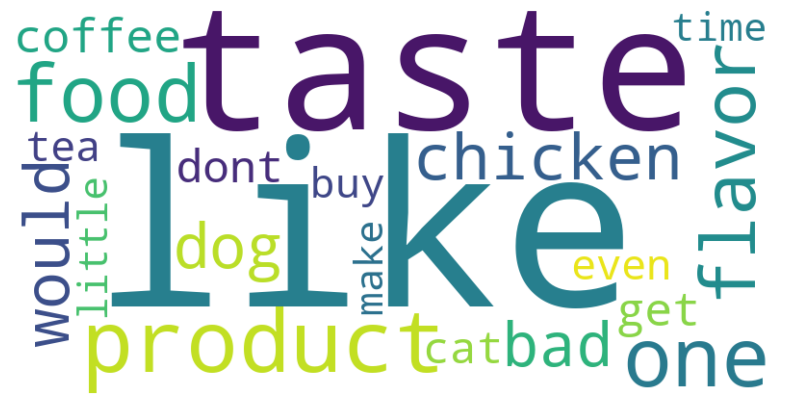

In [41]:
from wordcloud import WordCloud
import matplotlib.pyplot as plt


# Assuming 'common_words' is your list of common words and their counts
# Convert the list of tuples into a dictionary
word_freq = dict(common_words)

# Create a WordCloud object
wordcloud = WordCloud(width=800, height=400, background_color='white').generate_from_frequencies(word_freq)

# Plotting the WordCloud
plt.figure(figsize=(10, 5))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.show()

From the Above list of common words we can do manual analysis:
People dont like consuming products online like chicken, coffee , flavoured foods etc. 
Cat and Dog food is also very commonly ordered from the amazon eats which has negative reviews.
There are some irregularities like dont, little, one , would due to the nature of the dataset.


In [49]:
from sklearn.cluster import KMeans
# Extracting the 'Polarity' and 'Subjectivity' columns
# Applying K-means clustering
num_clusters = 3
kmeans = KMeans(n_clusters=num_clusters, random_state=0)
df['Cluster'] = kmeans.fit_predict(df[['Polarity', 'Subjectivity']])

# Displaying the first few rows with cluster labels
df.head()


C:\Users\vedan\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
C:\Users\vedan\anaconda3\Lib\site-packages\joblib\externals\loky\backend\context.py:110: UserWarning: Could not find the number of physical cores for the following reason:
[WinError 2] The system cannot find the file specified
Returning the number of logical cores instead. You can silence this warning by setting LOKY_MAX_CPU_COUNT to the number of cores you want to use.
  warnings.warn(
  File "C:\Users\vedan\anaconda3\Lib\site-packages\joblib\externals\loky\backend\context.py", line 199, in _count_physical_cores
    cpu_info = subprocess.run(
               ^^^^^^^^^^^^^^^
  File "C:\Users\vedan\anaconda3\Lib\subprocess.py", line 548, in run
    with Popen(*popenargs, **kwargs) as process:
         ^^^^^^^^^^^^^^^^

,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text,Cleaned_Text,Sentiment,Polarity,Subjectivity,Cluster
0,1,B001E4KFG0,A3SGXH7AUHU8GW,delmartian,1,1,5,1303862400,Good Quality Dog Food,I have bought several of the Vitality canned d...,bought several vitality canned dog food produc...,Positive,0.425000,0.400000,1
1,2,B00813GRG4,A1D87F6ZCVE5NK,dll pa,0,0,1,1346976000,Not as Advertised,Product arrived labeled as Jumbo Salted Peanut...,product arrived labeled jumbo salted peanutsth...,Negative,0.216667,0.762963,1
2,3,B000LQOCH0,ABXLMWJIXXAIN,"Natalia Corres ""Natalia Corres""",1,1,4,1219017600,"""Delight"" says it all",This is a confection that has been around a fe...,confection around century light pillowy citrus...,Positive,0.187000,0.548000,1
3,4,B000UA0QIQ,A395BORC6FGVXV,Karl,3,3,2,1307923200,Cough Medicine,If you are looking for the secret ingredient i...,looking secret ingredient robitussin believe f...,Negative,0.150000,0.650000,1
4,5,B006K2ZZ7K,A1UQRSCLF8GW1T,"Michael D. Bigham ""M. Wassir""",0,0,5,1350777600,Great taffy,Great taffy at a great price. There was a wid...,great taffy great price wide assortment yummy ...,Positive,0.458333,0.600000,2


In [50]:
pip install matplotlib seaborn


Note: you may need to restart the kernel to use updated packages.


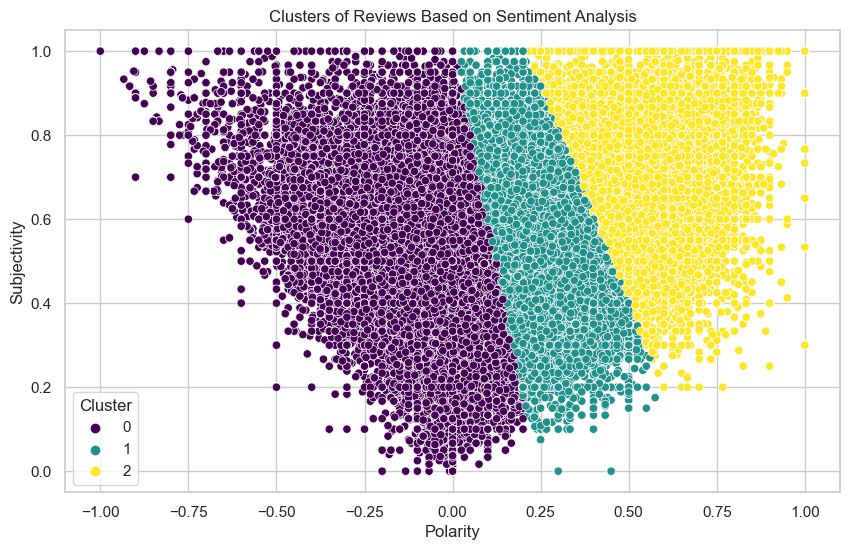

In [52]:
import matplotlib.pyplot as plt
import seaborn as sns

# Assuming df is your DataFrame with 'Polarity', 'Subjectivity', and 'Cluster' columns
sns.set(style="whitegrid")

plt.figure(figsize=(10, 6))
plt.title("Clusters of Reviews Based on Sentiment Analysis")
sns.scatterplot(x="Polarity", y="Subjectivity", hue="Cluster", data=df, palette="viridis", legend="full")
plt.xlabel("Polarity")
plt.ylabel("Subjectivity")
plt.show()


A large number of reviews (purple and blue clusters) seem to have neutral sentiment (polarity close to 0), with varying degrees of subjectivity.
The clear separation between clusters suggests that reviews can be distinctly categorized based on their sentiment.
Reviews in the yellow cluster are predominantly positive and also show a broad subjectivity range, meaning that even positive opinions vary in how much they are based on facts vs. personal feelings.
For business implications, the yellow cluster is generally where you want the majority of your reviews to be, as it indicates a positive reception. The presence of many reviews in the neutral clusters may suggest a need for further investigation to understand why customers are not having strongly positive experiences.

In [76]:
neg_comments = df[df.Sentiment == 'Negative']
neg_comments.head()

,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text,Cleaned_Text,Sentiment,Polarity,Subjectivity,Cluster
1,2,B00813GRG4,A1D87F6ZCVE5NK,dll pa,0,0,1,1346976000,Not as Advertised,Product arrived labeled as Jumbo Salted Peanut...,product arrived labeled jumbo salted peanutsth...,Negative,0.216667,0.762963,1
3,4,B000UA0QIQ,A395BORC6FGVXV,Karl,3,3,2,1307923200,Cough Medicine,If you are looking for the secret ingredient i...,looking secret ingredient robitussin believe f...,Negative,0.150000,0.650000,1
12,13,B0009XLVG0,A327PCT23YH90,LT,1,1,1,1339545600,My Cats Are Not Fans of the New Food,My cats have been happily eating Felidae Plati...,cat happily eating felidae platinum two year g...,Negative,0.096281,0.536088,0
16,17,B001GVISJM,A3KLWF6WQ5BNYO,Erica Neathery,0,0,2,1348099200,poor taste,I love eating them and they are good for watch...,love eating good watching tv looking movie swe...,Negative,0.462500,0.587500,2
26,27,B001GVISJM,A3RXAU2N8KV45G,lady21,0,1,1,1332633600,Nasty No flavor,"The candy is just red , No flavor . Just plan...",candy red flavor plan chewy would never buy,Negative,0.000000,0.000000,0


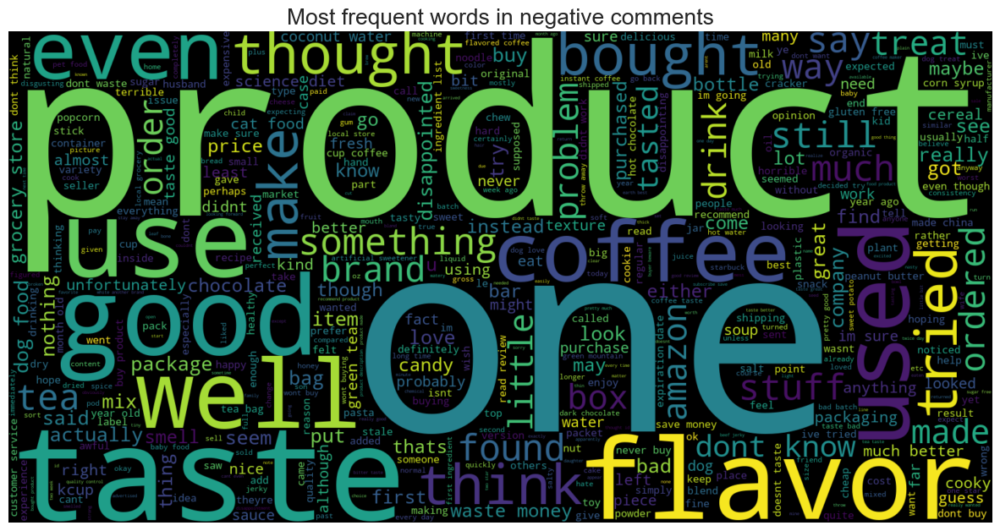

In [77]:
text = ' '.join([word for word in neg_comments['Cleaned_Text']])
plt.figure(figsize = (15,15), facecolor='None')
wordcloud = WordCloud(max_words=500, width=1600, height=800).generate(text)
plt.imshow(wordcloud,interpolation='bilinear')
plt.axis('off')
plt.title('Most frequent words in negative comments', fontsize=19)
plt.show()

In [78]:
neu_comments = df[df.Sentiment == 'Neutral']
neu_comments.head()

,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text,Cleaned_Text,Sentiment,Polarity,Subjectivity,Cluster
45,46,B001EO5QW8,A39Z97950MCTQE,K. A. Freel,0,0,3,1205193600,Hearty Oatmeal,This seems a little more wholesome than some o...,seems little wholesome supermarket brand somew...,Neutral,0.006250,0.350000,0
47,48,B001EO5QW8,A26AY1TFK8BQXQ,"kbogo ""shoelover""",1,2,3,1200096000,Mushy,"The flavors are good. However, I do not see a...",flavor good however see differce oaker oat bra...,Neutral,0.700000,0.600000,2
49,50,B001EO5QW8,A276999Y6VRSCQ,JMay,0,1,3,1334016000,Same stuff,This is the same stuff you can buy at the big ...,stuff buy big box store nothing healthy carbs ...,Neutral,0.066667,0.333333,0
53,54,B000G6RPMY,AQ9DWWYP2KJCQ,"Roel Trevino ""protomex""",0,0,3,1278028800,not ass kickin,we're used to spicy foods down here in south t...,used spicy food south texas spicy doubt much h...,Neutral,0.200000,0.200000,1
60,61,B004N5KULM,A1ZR8O62VSU4OK,"Lisa J. Szlosek ""lisa""",2,4,3,1318723200,Better price for this at Target,Watch your prices with this. While the assort...,watch price assortment good get gold box purch...,Neutral,0.700000,0.600000,2


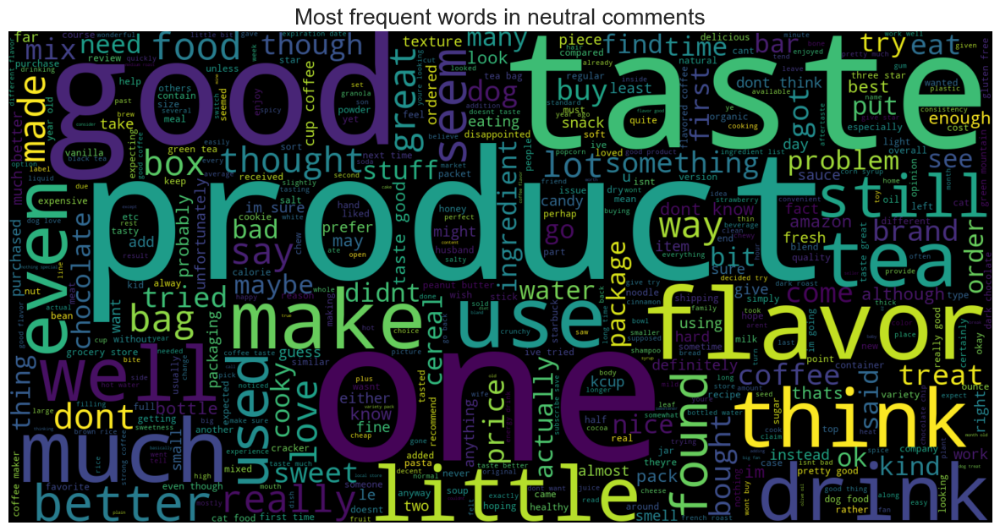

In [79]:
text = ' '.join([word for word in neu_comments['Cleaned_Text']])
plt.figure(figsize = (15,15), facecolor='None')
wordcloud = WordCloud(max_words=500, width=1600, height=800).generate(text)
plt.imshow(wordcloud,interpolation='bilinear')
plt.axis('off')
plt.title('Most frequent words in neutral comments', fontsize=19)
plt.show()

In [81]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import re
import string
import seaborn as sns
import nltk
from nltk import word_tokenize
from nltk.corpus import stopwords
from matplotlib import style
style.use('ggplot')
from textblob import TextBlob
from nltk.stem import PorterStemmer
nltk.download("wordnet")
from nltk.stem import WordNetLemmatizer
stop_words = set(stopwords.words('english'))
from wordcloud import WordCloud
from sklearn.feature_extraction.text import CountVectorizer

from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.svm import LinearSVC

from sklearn.model_selection import GridSearchCV
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report,ConfusionMatrixDisplay

[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\vedan\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


In [82]:
vect = CountVectorizer(ngram_range=(1,2)).fit(df['Cleaned_Text'])

In [84]:
feature_names = vect.get_feature_names_out()
print('Number of features: {}\n'.format(len(feature_names)))
print('First 20 features: \n{}'.format(feature_names[:20]))

Number of features: 4240160

First 20 features: 
['aa' 'aa actually' 'aa alimentum' 'aa amazon' 'aa aroma' 'aa battery'
 'aa best' 'aa big' 'aa brand' 'aa caffeneand' 'aa came' 'aa cell'
 'aa coffee' 'aa conclude' 'aa dark' 'aa day' 'aa didnt' 'aa double'
 'aa etc' 'aa ethiopian']


In [85]:
X = df['Cleaned_Text']
Y = df['Sentiment']
X = vect.transform(X)

In [87]:
x_train,x_test,y_train,y_test = train_test_split(X,Y,test_size=0.2,random_state = 42)

In [88]:
print('Size of x_train:',(x_train.shape))
print('Size of y_train:',(y_train.shape))
print('Size of x_test:',(x_test.shape))
print('Size of y_test:',(y_test.shape))

Size of x_train: (400000, 4240160)
Size of y_train: (400000,)
Size of x_test: (100000, 4240160)
Size of y_test: (100000,)


In [89]:
logreg = LogisticRegression()
logreg.fit(x_train,y_train)
logreg_pred = logreg.predict(x_test)
logreg_acc = accuracy_score(logreg_pred,y_test)
print('Test accuracy : {:.2f}%'.format(logreg_acc*100))

C:\Users\vedan\anaconda3\Lib\site-packages\sklearn\linear_model\_logistic.py:460: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


Test accuracy : 91.68%


In [90]:
print(confusion_matrix(y_test, logreg_pred))
print('\n')
print(classification_report(y_test, logreg_pred))

[[11599   561  2204]
 [ 1216  3961  2531]
 [ 1071   736 76121]]


              precision    recall  f1-score   support

    Negative       0.84      0.81      0.82     14364
     Neutral       0.75      0.51      0.61      7708
    Positive       0.94      0.98      0.96     77928

    accuracy                           0.92    100000
   macro avg       0.84      0.77      0.80    100000
weighted avg       0.91      0.92      0.91    100000



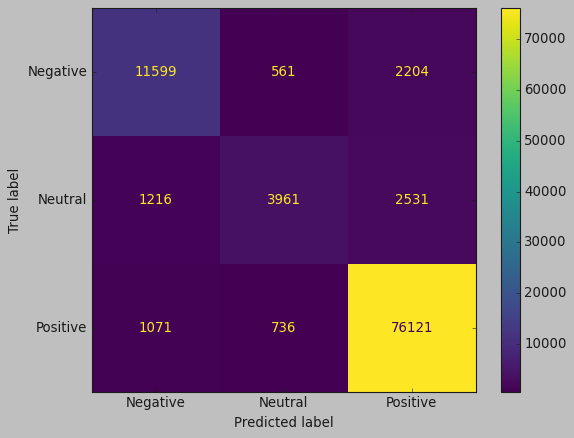

In [91]:
style.use('classic')
cm = confusion_matrix(y_test, logreg_pred, labels = logreg.classes_)
disp = ConfusionMatrixDisplay(confusion_matrix = cm, display_labels = logreg.classes_)
disp.plot()

The output of the confusion matrix and classification report you've shared provides valuable insights from the sentiment analysis performed using logistic regression on the dataset with the 'Cleaned_Text' column as the feature (x) and 'Sentiment score' as the target (y). These scores are categorized into three classes: Positive, Negative, and Neutral. Let's break down the insights:

##### Model Performance Overview:

###### Accuracy:
The model has an overall accuracy of 92%. This means that 92% of the time, the model correctly predicts the sentiment of the text.
###### Weighted Average Precision, Recall, and F1-score:
The weighted averages consider the imbalance in the dataset (if any). The precision is 91%, recall is 92%, and the F1-score is 91%, indicating a strong overall performance.
Class-wise Performance:

###### Negative Sentiment:
Precision: 84% (proportion of true negatives among all predicted negatives).
Recall: 81% (proportion of true negatives identified correctly).
F1-Score: 82% (harmonic mean of precision and recall).
###### Neutral Sentiment:
Precision: 75%.
Recall: 51%. This is relatively low, indicating that the model struggles more with correctly identifying neutral sentiments.
F1-Score: 61%.
###### Positive Sentiment:
Precision: 94%.
Recall: 98%. This high value shows that the model is particularly effective at identifying positive sentiments.
F1-Score: 96%.
Confusion Matrix Analysis:

Positive Sentiment has the highest number of true positives (76121), indicating that the dataset might be imbalanced with a higher number of positive samples.
###### Misclassifications:
A significant number of Negative (2204) and Neutral (2531) sentiments are incorrectly classified as Positive.
Neutral sentiments are often misclassified as either Negative or Positive, which could be due to the inherent ambiguity in neutral text.
###### Implications for Sentiment Analysis:

The model is highly effective at identifying positive sentiments, but less so for neutral ones. This could be critical for applications where distinguishing neutral sentiments is as important as identifying positive or negative ones.
The misclassification between negative and positive sentiments is relatively low, suggesting that the model is quite good at distinguishing between these two extremes.
Potential Use Cases:

###### Customer Feedback Analysis:
Understanding customer sentiment towards products or services.
Social Media Monitoring: Gauging public opinion or reaction towards events, policies, or brand mentions.
Market Research: Identifying trends and general sentiment in market-related discussions.
###### Suggestions for Improvement:

If the dataset is imbalanced, techniques like SMOTE (Synthetic Minority Over-sampling Technique) or adjusting class weights in the model could improve performance, especially for the underrepresented classes.
Tuning the model parameters or trying different feature extraction techniques (like TF-IDF, word embeddings) might improve the differentiation ability, particularly for neutral sentiments.
Since neutral sentiments are hard to capture, a more in-depth analysis of misclassified instances could provide insights into why the model is struggling and how to improve it.
In summary, the analysis indicates a strong performance in identifying positive and negative sentiments, with some challenges in accurately classifying neutral sentiments. This can guide further model improvements and the application of this sentiment analysis in various domains

In [94]:
#Save the dataset as new
d.to_csv('clean_data.csv', index=False)

In [103]:
df.head()

,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text,Cleaned_Text,Sentiment,Polarity,Subjectivity,Cluster
0,1,B001E4KFG0,A3SGXH7AUHU8GW,delmartian,1,1,5,1303862400,Good Quality Dog Food,I have bought several of the Vitality canned d...,bought several vitality canned dog food produc...,Positive,0.425000,0.400000,1
1,2,B00813GRG4,A1D87F6ZCVE5NK,dll pa,0,0,1,1346976000,Not as Advertised,Product arrived labeled as Jumbo Salted Peanut...,product arrived labeled jumbo salted peanutsth...,Negative,0.216667,0.762963,1
2,3,B000LQOCH0,ABXLMWJIXXAIN,"Natalia Corres ""Natalia Corres""",1,1,4,1219017600,"""Delight"" says it all",This is a confection that has been around a fe...,confection around century light pillowy citrus...,Positive,0.187000,0.548000,1
3,4,B000UA0QIQ,A395BORC6FGVXV,Karl,3,3,2,1307923200,Cough Medicine,If you are looking for the secret ingredient i...,looking secret ingredient robitussin believe f...,Negative,0.150000,0.650000,1
4,5,B006K2ZZ7K,A1UQRSCLF8GW1T,"Michael D. Bigham ""M. Wassir""",0,0,5,1350777600,Great taffy,Great taffy at a great price. There was a wid...,great taffy great price wide assortment yummy ...,Positive,0.458333,0.600000,2
